# Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow Hub.

## 1. Problem

I want to be able to identify a dog breed from an image

## 2. Data

The data we're using is from Kaggle's dog breed identification competition

https://www.kaggle.com/c/dog-breed-identification/data?select=labels.csv

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image

## 4. Features

Some information about the data:

* We're dealing with images (unstructered data) so it's probably best to use deep learning/transfer learning.
* There are 120 breeds of dogs
* There is roughly 10,000 images in the training set (has labels)
* There is roughly 10,000 images in the test set (no labels)



In [1]:
!python --version

Python 3.6.9


In [2]:
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub

print('TF version: {}'.format(tf.__version__))
print('TH Hub version: {}'.format(hub.__version__))

# Check for GPU availability
print('GPU available! :)' if tf.config.list_physical_devices('GPU') else 'GPU not available :(')

DRIVE_LOCATION = '/content/drive/My Drive/Colab Notebooks/'

def to_path(path):
  DRIVE_LOCATION = '/content/drive/My Drive/Colab Notebooks/'
  return DRIVE_LOCATION + path

TF version: 2.4.1
TH Hub version: 0.11.0
GPU available! :)


In [3]:
# !unzip "drive/MyDrive/Colab Notebooks/dog-data/dog-breed-identification.zip" -d "drive/MyDrive/Colab Notebooks/dog-data/"

## Getting the data ready

turning the images into tensors

In [4]:
labels_csv = pd.read_csv(DRIVE_LOCATION + 'dog-data/labels.csv')
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fc6df38f35361d2630568b993a596008  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


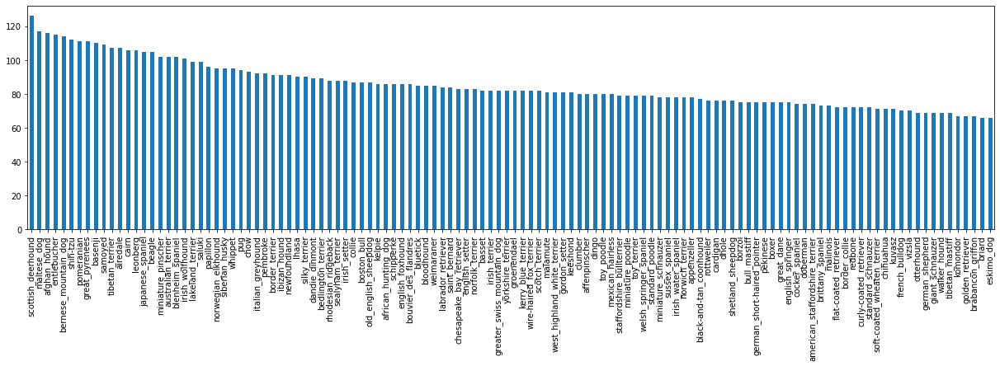

In [5]:
# How many images are there of each breed?
labels_csv.breed.value_counts().plot.bar(figsize=(21,5));

In [6]:
labels_csv.breed.value_counts().mean()

85.18333333333334

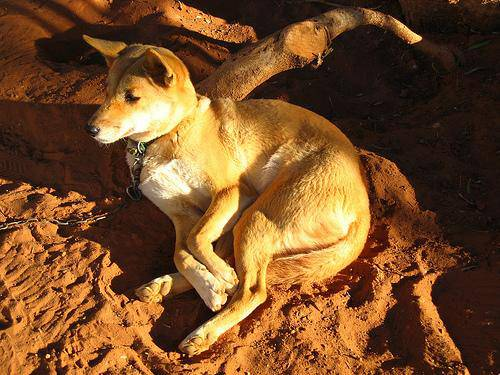

In [7]:
# let's view an image
from IPython.display import Image
Image(to_path('dog-data/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg'))

### Getting images and their labels

Let's get a list of all of our iamge file pathnames

In [8]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [9]:
filenames = [to_path('dog-data/train/{}.jpg'.format(fid)) for fid in labels_csv['id']]

filenames[:10]

['/content/drive/My Drive/Colab Notebooks/dog-data/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [10]:
import os 
if len(os.listdir(to_path('dog-data/train/'))) == len(filenames):
  print('lengths match. good to go')
else:
  print('something is not right')

lengths match. good to go


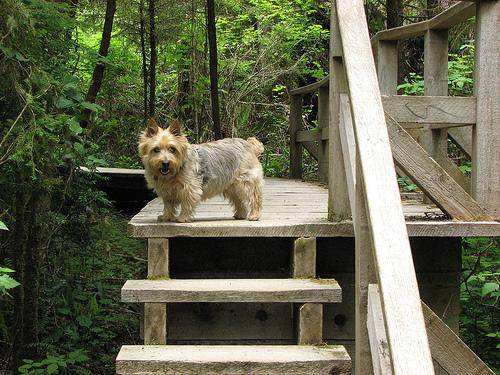

In [11]:
Image(filenames[9003])

In [12]:
labels = labels_csv.breed.to_numpy()
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [13]:
labels.size

10222

In [14]:
if labels.size == len(filenames):
  print('Number of labels matches number of filenames!')
else:
  print('does not match, something is wrong')

Number of labels matches number of filenames!


In [15]:
unique_breeds = np.unique(labels)
unique_breeds.size

120

In [16]:
# turn labels into a boolean array 
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

####Interesting comparison mechanism for NumPy's arrays

`==` compares for all array elements unlike normal array comparison

In [17]:
# regular array comparison
print('4 == [1, 2, 3, 4, 5, 6] \nresult: {}'.format(4 == [1, 2, 3, 4, 5, 6]))
# numpy array comparison
print('4 == np.array([1, 2, 3, 4, 5, 6]) \nresult: {}'.format(4 == np.array([1, 2, 3, 4, 5, 6])))

4 == [1, 2, 3, 4, 5, 6] 
result: False
4 == np.array([1, 2, 3, 4, 5, 6]) 
result: [False False False  True False False]


In [18]:
# Turn every label into a boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [19]:
len(boolean_labels)

10222

In [20]:
# Example: turning boolean array into integers
print(labels[0]) # original labels
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index
print(boolean_labels[0].astype(int)) 

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Creating a validation set

In [21]:
# Create X/y
X = filenames
y = boolean_labels

We're going to start off experimenting with ~1000 images and increase as needed

In [22]:
# set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:'slider', min:1000, max:10000, step:1000}

In [23]:
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES

X_train, X_valid, y_train, y_valid = train_test_split(X[:NUM_IMAGES],
                                                      y[:NUM_IMAGES],
                                                      test_size=.2,
                                                      random_state=42)

len(X_train), len(X_valid), len(y_train), len(y_valid)

(800, 200, 800, 200)

In [24]:
X_train[:5], y_train[:2]

(['/content/drive/My Drive/Colab Notebooks/dog-data/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/My Drive/Colab Notebooks/dog-data/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/My Drive/Colab Notebooks/dog-data/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/My Drive/Colab Notebooks/dog-data/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/My Drive/Colab Notebooks/dog-data/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         F

## Preprocessing Images (turning images into Tensors)

In [25]:
# Convert an image to NumPy array
from matplotlib.pyplot import imread

image = imread(filenames[42])
image.shape

(257, 350, 3)

In [26]:
# image to tensor
tf.constant(image)

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

In [27]:
def process_image(image_path, image_size=224):
  """
  input file_path to image and turns target image into a tensor
  default image size is 224x224
  """
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into a numerical tensor with 3 color channels
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the color channel values from 0-255 to 0-1
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value 224x224
  image = tf.image.resize(image, size=[image_size, image_size])

  return image

## Turning our data into batches

In [28]:
# before batches we need to form tensor tuples like `(image, label)`
tensor_tuplify = lambda image, label: (process_image(image), label)

In [29]:
tensor_tuplify(X[42], y[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

In [30]:
def batch_data(X, y=None, batch_size=32, is_validation_data=False, is_test_data=False):
  """
  Create batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shiffle if it's validation data
  Also accepts test data as input (no labels)
  """
  if is_test_data:
    print('Creating test data batches ...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only file paths (no labels)
    data_batch = data.map(process_image).batch(batch_size)
    return data_batch

  elif is_validation_data:
    print('Creating validation data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(tensor_tuplify).batch(batch_size)
    return data_batch
  
  else:
    print('Creating training data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(y))) # labels
    data = data.shuffle(buffer_size=len(X))
    data_batch = data.map(tensor_tuplify).batch(batch_size)
    return data_batch

In [31]:
# Create training and validation data batches
train_data = batch_data(X_train, y_train)
val_data = batch_data(X_valid, y_valid, is_validation_data=True)

Creating training data batches...
Creating validation data batches...


In [32]:
# Check out different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

In [33]:
import matplotlib.pyplot as plt

def show_25_image(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch
  """

  plt.figure(figsize=(10,10))
  for i in range(25):
    ax = plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis('off')

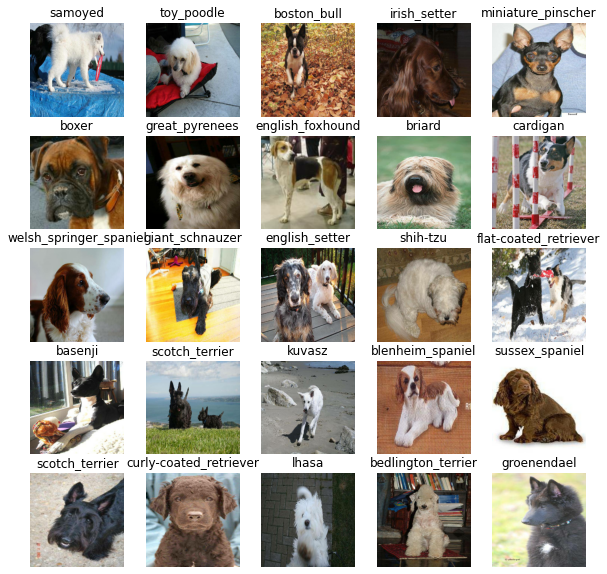

In [34]:
# Now let's visualize the data in a training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_image(train_images, train_labels)

## Building a model


In [35]:
# Setup input shape to the model
IMG_SIZE = 224
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3]
OUTPUT_SHAPE = len(unique_breeds)

# Setup URL from TensorFlow Hub
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4'

putting this into a Keras deep learning model: https://www.tensorflow.org/guide/keras/sequential_model

In [36]:
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print('Building model with: {}'.format(model_url))

  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), # Layer 1 (input layer)
      tf.keras.layers.Dense(units=output_shape,
                            activation='softmax') # layer 2 (output layer)
  ])

  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  model.build(input_shape)

  return model

In [37]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks 

2 callbacks:
* TensorBoard
* Early stopping

In [38]:
# Load TensorBoard notebook extension
%load_ext tensorboard

In [39]:
import datetime

def create_tensorboard_callback():
  log_dir = os.path.join(to_path('logs/'),
                        datetime.datetime.now().strftime('%Y%m%d-%H%M%S'))
  return tf.keras.callbacks.TensorBoard(log_dir)

In [40]:
# Early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience=3)

## Training a model (on a subset of data)

In [41]:
NUM_EPOCHS = 100#@param {type:'slider', min: '10', max:'100', step: '10'}

In [42]:
print('GPU available' if tf.config.list_physical_devices('GPU') else 'GPU not available')

GPU available


In [43]:
def train_model():
  """
  Trains a given model and returns the trained version
  """
  mode = create_model()

  # create tensorboard session 
  tensorboard = create_tensorboard_callback()

  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  
  return model


In [ ]:
# Fit the model
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 274s 11s/step - loss: 4.6283 - accuracy: 0.0850 - val_loss: 3.2848 - val_accuracy: 0.3150
Epoch 2/100
25/25 [==============================] - 4s 174ms/step - loss: 1.6449 - accuracy: 0.6862 - val_loss: 2.0161 - val_accuracy: 0.5500
Epoch 3/100
25/25 [==============================] - 4s 175ms/step - loss: 0.5749 - accuracy: 0.9312 - val_loss: 1.5843 - val_accuracy: 0.6000
Epoch 4/100
25/25 [==============================] - 4s 172ms/step - loss: 0.2573 - accuracy: 0.9850 - val_loss: 1.4001 - val_accuracy: 0.6550
Epoch 5/100
25/25 [==============================] - 4s 172ms/step - loss: 0.1493 - accuracy: 0.9937 - val_loss: 1.3168 - val_accuracy: 0.6650
Epoch 6/100
25/25 [==============================] - 4s 173ms/step - loss: 0.1019 - accuracy: 1.0000 - val_loss: 1.2755 - val_accuracy: 0.6650
Epoch 7/100
25/25 [==============================

### Checking the tensorBoard Logs

`%tensorboard` will access log directory

In [ ]:
%tensorboard --logdir drive/MyDrive/Colab\ Notebooks/logs

Output hidden; open in https://colab.research.google.com to view.

## Making and evaluating predictions using a trained model

In [ ]:
# Make predictions on validation data (not used to train on)
predictions = model.predict(val_data, verbose=1)
predictions

7/7 [==============================] - 1s 130ms/step


array([[2.6009227e-03, 3.8441987e-05, 4.3666828e-04, ..., 3.6126404e-04,
        5.5817127e-05, 2.1218963e-03],
       [6.4516102e-04, 1.2494643e-03, 8.9562302e-03, ..., 7.3151127e-04,
        8.3878741e-04, 9.5572337e-05],
       [2.0449882e-06, 9.9485715e-06, 4.5309121e-06, ..., 8.4515314e-06,
        1.9143903e-05, 1.3342420e-04],
       ...,
       [1.2614564e-05, 5.4549222e-05, 1.1562352e-04, ..., 9.3757608e-06,
        2.6837053e-05, 4.4319117e-05],
       [1.9940105e-03, 9.7759556e-05, 8.6536595e-05, ..., 1.4584896e-04,
        2.5166109e-05, 9.4455080e-03],
       [1.9102789e-03, 1.3154364e-05, 4.2969245e-03, ..., 7.9060765e-03,
        2.8223556e-04, 8.1087106e-05]], dtype=float32)

In [ ]:
unique_breeds[y_valid[20] == True], y_valid[16]

(array(['flat-coated_retriever'], dtype=object),
 array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False,  True, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]

In [ ]:
def print_pred_details(n):
  prediction_list = predictions[n].copy()
  df = pd.DataFrame(prediction_list)
  df.sort_values
  keys = df.sort_values(0)[-5:].index
  df.values
  for k in keys:
    print('%{} \t{}'.format(round(df[df.index == k].values[0][0]*100,2), unique_breeds[df[df.index == k].index[0]]))

%4.16 	maltese_dog
%5.46 	miniature_schnauzer
%14.37 	shih-tzu
%18.98 	tibetan_terrier
%44.65 	dandie_dinmont


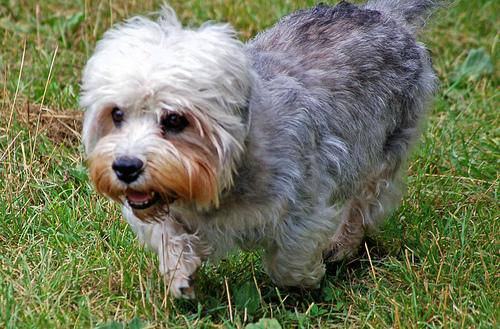

In [ ]:
n=30
print_pred_details(n)
Image(X_valid[n])

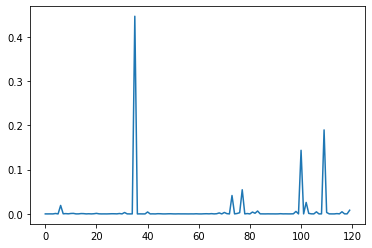

In [ ]:
pd.Series(predictions[n]).plot();

In [ ]:
# First prediction
index = 42
# print(predictions[index])
print('Max Value (probability of prediction): {}'.format(np.max(predictions[index])))
print('Sum: {}'.format(np.sum(predictions[index])))
print('Max index: {}'.format(np.argmax(predictions[index])))
print('Predicted label: {}'.format(unique_breeds[np.argmax(predictions[index])]))


Max Value (probability of prediction): 0.5685782432556152
Sum: 1.0000001192092896
Max index: 39
Predicted label: english_foxhound


In [ ]:
# Turn predicion probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

pred_label = get_pred_label(predictions[81])
pred_label

'dingo'

In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# function to rip/unbacth batch dataset

def unbatchify(batch_data):
  images_ = []
  labels_ = []

  for image, label in batch_data.unbatch().as_numpy_iterator():
    images_.append(image)
    labels_.append(unique_breeds[np.argmax(label)])

  return images_, labels_



In [ ]:
# Compare real label vs prediction
val_images, val_labels = unbatchify(val_data)
get_pred_label(val_labels[0]), get_pred_label(predictions[0])

('affenpinscher', 'irish_wolfhound')

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  pred_label = get_pred_label(pred_prob)

  plt.imshow(val_images[n])
  plt.xticks([])
  plt.yticks([])

  plt.title('{} {:2.0f}% {}'.format(
      pred_label,
      np.max(pred_prob)*100,
      true_label
  ), color='green' if pred_label == true_label else 'red')


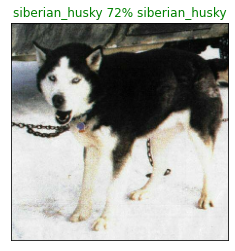

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=85)

In [ ]:
def plot_pred_conf(predication_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """

  pred_prob, true_label = predication_probabilities[n], labels[n]

  pred_label = get_pred_label(pred_prob)
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color='grey')
  
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation='vertical')
  
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels==true_label)].set_color('lightgreen')

In [ ]:
predictions[0][:5]

array([2.6009227e-03, 3.8441987e-05, 4.3666828e-04, 2.1702017e-05,
       3.5454292e-04], dtype=float32)

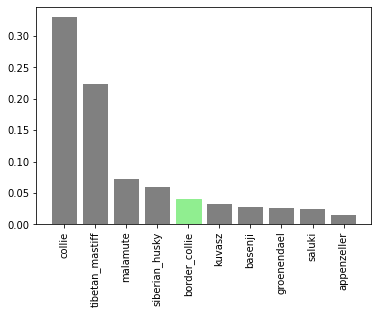

In [ ]:
plot_pred_conf(predication_probabilities=predictions, labels=val_labels, n=9)

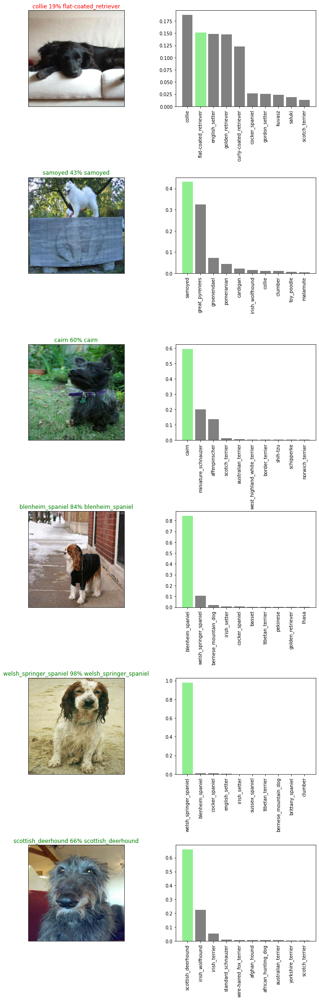

In [ ]:
i_multiplier = 20
num_rows = 6
num_cols = 1
num_images = num_rows * num_cols

plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2 * num_cols, 2*i+1)
  plot_pred(
      prediction_probabilities=predictions,
      labels=val_labels,
      images=val_images,
      n=i+i_multiplier
  )
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(
      predication_probabilities=predictions,
      labels=val_labels,
      n=i+i_multiplier    
  )

plt.tight_layout(h_pad=.5)
plt.show()

In [ ]:
# save model function
def save_model(model, suffix=None):
  """
  Saves a given model in the 'models' directory abd appends a suffix (string).
  """
  modeldir = os.path.join(to_path('models'),
                          datetime.datetime.now().strftime('%Y%m%d-%H%M%s'))
  model_path = modeldir + '-' + suffix + '.h5' # .h5 is the save format
  print('Saving model to: {}'.format(model_path))
  model.save(model_path)
  return model_path

In [ ]:
# load model function
def load_model(model_path):
  print('Loading model from: {}'.format(model_path))
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={'KerasLayer': hub.KerasLayer})
  return model

In [ ]:
save_model(model, suffix='1000-images-model')

Saving model to: /content/drive/My Drive/Colab Notebooks/models/20210130-03511611978705-1000-images-model.h5


'/content/drive/My Drive/Colab Notebooks/models/20210130-03511611978705-1000-images-model.h5'

In [ ]:
loaded_1000_image_model = load_model(to_path('models/20210129-01141611882892-1000-images-model.h5'))

Loading model from: /content/drive/My Drive/Colab Notebooks/models/20210129-01141611882892-1000-images-model.h5


In [ ]:
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 1s 117ms/step - loss: 1.2773 - accuracy: 0.6750


[1.2773226499557495, 0.675000011920929]

In [ ]:
model.evaluate(val_data)

7/7 [==============================] - 1s 117ms/step - loss: 5.5618 - accuracy: 0.0000e+00


[5.609936714172363, 0.0]

## Training a model on the full data

In [ ]:
len(X), len(y)

In [ ]:
# Create a data batch witht he full dataset
full_data = batch_data(X, y)

In [ ]:
full_model = create_model()

In [ ]:
full_model_tensorboard = create_tensorboard_callback()
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor='accuracy',
                                                             patience=3)

In [ ]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 43s 127ms/step - loss: 2.3794 - accuracy: 0.4820
Epoch 2/100
320/320 [==============================] - 39s 122ms/step - loss: 0.3915 - accuracy: 0.8868
Epoch 3/100
320/320 [==============================] - 38s 120ms/step - loss: 0.2313 - accuracy: 0.9430
Epoch 4/100
320/320 [==============================] - 38s 119ms/step - loss: 0.1494 - accuracy: 0.9652
Epoch 5/100
320/320 [==============================] - 39s 121ms/step - loss: 0.0969 - accuracy: 0.9824
Epoch 6/100
320/320 [==============================] - 38s 120ms/step - loss: 0.0717 - accuracy: 0.9895
Epoch 7/100
320/320 [==============================] - 38s 119ms/step - loss: 0.0555 - accuracy: 0.9928
Epoch 8/100
320/320 [==============================] - 38s 120ms/step - loss: 0.0411 - accuracy: 0.9963
Epoch 9/100
320/320 [==============================] - 39s 120ms/step - loss: 0.0340 - accuracy: 0.9965
Epoch 10/100
320/320 [==============================] - 38s 120m

In [ ]:
save_model(full_model, suffix='full-data-model')

Saving model to: /content/drive/My Drive/Colab Notebooks/models/20210129-01401611884422-full-data-model.h5


'/content/drive/My Drive/Colab Notebooks/models/20210129-01401611884422-full-data-model.h5'

In [ ]:
loaded_full_model = load_model(to_path('models/20210129-01401611884422-full-data-model.h5'))

Loading model from: /content/drive/My Drive/Colab Notebooks/models/20210129-01401611884422-full-data-model.h5


In [ ]:
test_filenames = [to_path('dog-data/test/{}'.format(fid)) for fid in os.listdir(to_path('dog-data/test/'))]
test_filenames[:10]

['/content/drive/My Drive/Colab Notebooks/dog-data/test/000621fb3cbb32d8935728e48679680e.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/00102ee9d8eb90812350685311fe5890.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/0012a730dfa437f5f3613fb75efcd4ce.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/001510bc8570bbeee98c8d80c8a95ec1.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/001a5f3114548acdefa3d4da05474c2e.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/00225dcd3e4d2410dd53239f95c0352f.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/002c2a3117c2193b4d26400ce431eebd.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/002c58d413a521ae8d1a5daeb35fc803.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/002f80396f1e3db687c5932d7978b196.jpg',
 '/content/drive/My Drive/Colab Notebooks/dog-data/test/0036c6bcec6031be9e62a257b1c3c442.jpg']

In [ ]:
test_data = batch_data(test_filenames, is_test_data=True)

Creating test data batches ...


In [ ]:
test_data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 41s 126ms/step


In [ ]:
test_predictions[:10]

array([[4.15566019e-12, 8.63963523e-13, 1.91825413e-15, ...,
        1.32529255e-13, 4.12238646e-11, 4.16546875e-12],
       [3.56678720e-06, 1.58783814e-06, 1.45651660e-08, ...,
        5.17294020e-11, 2.73581605e-07, 9.65279856e-10],
       [1.38169918e-11, 8.69791791e-07, 7.79369191e-09, ...,
        1.42596921e-08, 6.35431031e-12, 9.94102283e-12],
       ...,
       [8.06721578e-10, 7.57715765e-11, 2.88626831e-11, ...,
        8.07236005e-13, 1.77172469e-12, 8.72444894e-11],
       [2.44506151e-12, 1.11681726e-10, 6.44923420e-11, ...,
        8.87184655e-08, 1.68514691e-09, 1.64321647e-11],
       [7.77365561e-10, 2.61821970e-11, 2.86864803e-12, ...,
        1.43263363e-12, 4.05345158e-12, 3.12273833e-08]], dtype=float32)